# Author
- Full Name: Quan Hoang Ngoc
- ID: 22521178

In [4]:
print("oke")
import torch
print(torch.__version__)

oke
2.5.1+cu121


In [5]:
import os
root = os.getcwd() + "/"
root

'/content/'

# Load corpus

In [6]:
import pickle

# root = '/kaggle/input/toy-data/'
with open(root + 'train_data.pkl', 'rb') as file:
    train_data = pickle.load(file)
    train_data = train_data.reset_index(drop=True)

with open(root + 'test_data.pkl', 'rb') as file:
    test_data = pickle.load(file)
    test_data = test_data.reset_index(drop=True)

train_data

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,output
0,0.910187,-0.831170,-0.226428,NaN,-0.875475,0.217134,1.222727,-0.512556,-0.047319,NaN,...,-1.146077,NaN,-0.134081,-0.702698,NaN,1.851776,0.144824,NaN,0.987155,-0.946181
1,NaN,NaN,0.629110,NaN,0.470202,0.343496,NaN,-1.613149,-0.076462,0.107636,...,NaN,NaN,NaN,0.515115,1.333280,1.011613,1.626771,NaN,0.239772,14.133887
2,0.348541,2.525876,NaN,NaN,-0.318007,-1.116323,NaN,NaN,1.239082,-1.363543,...,-1.668386,2.901917,0.283982,NaN,-0.188287,NaN,1.137473,-1.111602,NaN,-1.430724
3,0.159977,NaN,1.553130,0.220560,0.482858,-0.199672,NaN,-1.239851,-0.262116,NaN,...,0.822290,NaN,-0.275694,1.053683,-0.437011,1.112376,NaN,NaN,NaN,4.648505
4,NaN,-0.525681,1.186990,-0.381421,NaN,-1.239271,-0.258730,0.639371,-0.759816,-1.166033,...,NaN,1.800030,1.436179,1.833793,-0.343086,NaN,1.136335,0.462849,-1.600174,5.178535
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79995,NaN,-0.044812,NaN,NaN,NaN,2.019333,1.348500,-0.885456,-0.825014,NaN,...,0.793136,0.203618,NaN,NaN,NaN,0.684924,-0.105613,0.800815,-1.803907,-13.609796
79996,-0.842941,-0.596813,-0.081617,0.840165,NaN,-0.043477,1.628749,1.293752,1.404483,NaN,...,-0.653812,-0.808742,-0.299700,0.343066,-1.020893,2.068271,0.630919,-1.103795,-1.243763,4.460943
79997,NaN,NaN,-1.583660,NaN,0.789714,-1.703597,1.462772,-1.089665,-0.380353,NaN,...,0.748042,0.657009,NaN,1.544420,-1.281983,-1.274629,-1.845257,-0.086250,-1.410400,-6.322682
79998,0.269784,NaN,-1.025943,0.024647,-1.334827,-0.124077,1.636105,0.822859,-0.923119,-0.072429,...,-0.062514,1.041108,0.653008,2.484144,1.192477,NaN,0.677150,-0.202443,-1.127504,1.808187


In [7]:
train_data.info(), test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80000 entries, 0 to 79999
Data columns (total 21 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   feature_1   56054 non-null  float64
 1   feature_2   56022 non-null  float64
 2   feature_3   56054 non-null  float64
 3   feature_4   56039 non-null  float64
 4   feature_5   55997 non-null  float64
 5   feature_6   56025 non-null  float64
 6   feature_7   55921 non-null  float64
 7   feature_8   56002 non-null  float64
 8   feature_9   56162 non-null  float64
 9   feature_10  55966 non-null  float64
 10  feature_11  55931 non-null  float64
 11  feature_12  56021 non-null  float64
 12  feature_13  56064 non-null  float64
 13  feature_14  55940 non-null  float64
 14  feature_15  56085 non-null  float64
 15  feature_16  56080 non-null  float64
 16  feature_17  55864 non-null  float64
 17  feature_18  56021 non-null  float64
 18  feature_19  56117 non-null  float64
 19  feature_20  56018 non-nul

(None, None)

In [8]:
train_data.describe()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,output
count,56054.000000,56022.000000,56054.000000,56039.000000,55997.000000,56025.000000,55921.000000,56002.000000,56162.000000,55966.000000,...,56021.000000,56064.000000,55940.000000,56085.000000,56080.000000,55864.000000,56021.000000,56117.000000,56018.000000,80000.000000
mean,0.003417,0.003507,-0.007777,-0.002284,0.004007,-0.002960,0.006616,0.002342,0.000481,-0.003760,...,-0.004280,-0.003770,-0.001205,-0.000409,-0.005168,-0.002213,0.002324,0.003763,0.010229,2.949868
std,0.999813,1.003594,0.999600,0.999555,0.996883,1.004879,1.003111,0.998860,0.998054,1.005091,...,1.003493,1.001635,1.009203,1.000726,1.003616,1.001498,0.997362,1.002123,0.998825,9.946372
min,-4.227232,-4.465604,-4.312973,-4.513469,-3.960696,-3.969358,-4.404214,-3.992446,-4.415184,-4.142430,...,-3.871217,-4.829436,-4.413886,-4.419923,-4.164295,-4.280225,-4.319465,-4.484079,-4.157734,-40.893258
25%,-0.671872,-0.672581,-0.681494,-0.677509,-0.666450,-0.681822,-0.668489,-0.670462,-0.677413,-0.683484,...,-0.681583,-0.679589,-0.675347,-0.670106,-0.679152,-0.675968,-0.669740,-0.670636,-0.667104,-3.727445
50%,0.003542,0.001857,-0.001674,-0.000011,0.009262,0.001647,0.007417,-0.000577,-0.000123,-0.007895,...,-0.007779,-0.008402,0.003721,-0.002402,-0.006058,-0.001925,0.001392,0.002770,0.020745,2.654494
75%,0.673402,0.680613,0.664572,0.671866,0.673356,0.677548,0.684097,0.676488,0.677830,0.674193,...,0.668814,0.671020,0.674545,0.670293,0.669368,0.677351,0.673944,0.677285,0.683596,9.266443
max,4.337424,3.758164,4.156753,4.479084,4.526784,3.995905,4.153257,4.365279,3.989945,4.289893,...,4.611257,3.765462,3.793137,4.005590,4.301546,4.065266,4.827623,4.386935,4.595828,65.813947


## Valid distributions

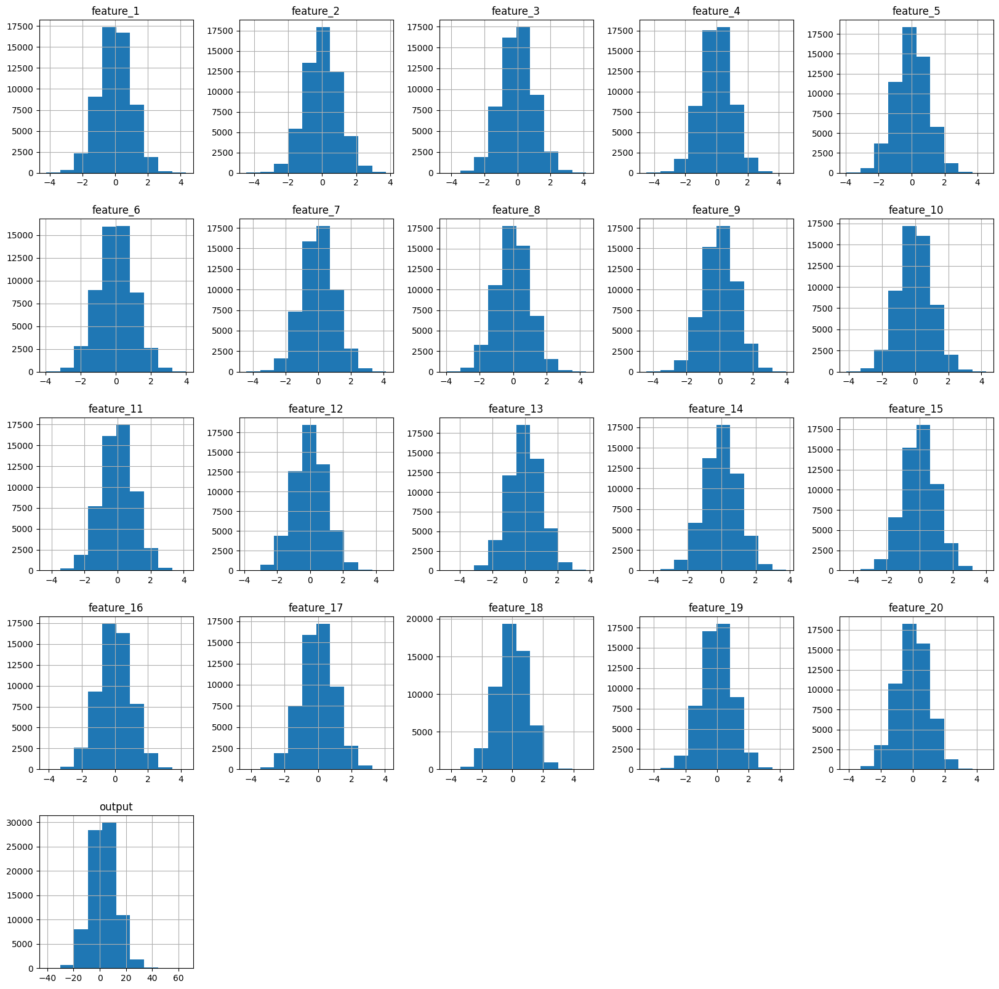

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histograms for numerical features
df = train_data #!!!
df.hist(figsize=(20, 20))
plt.show()

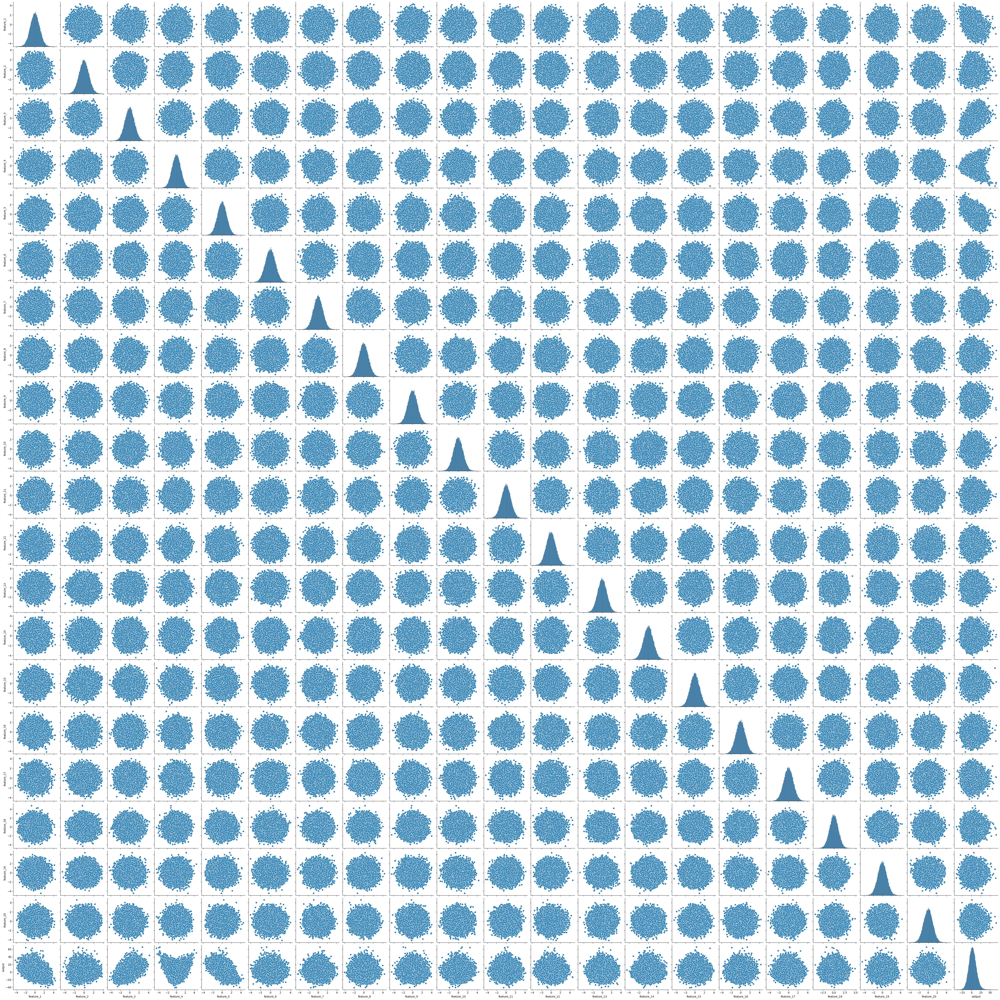

In [10]:
sns.pairplot(df)
plt.show()

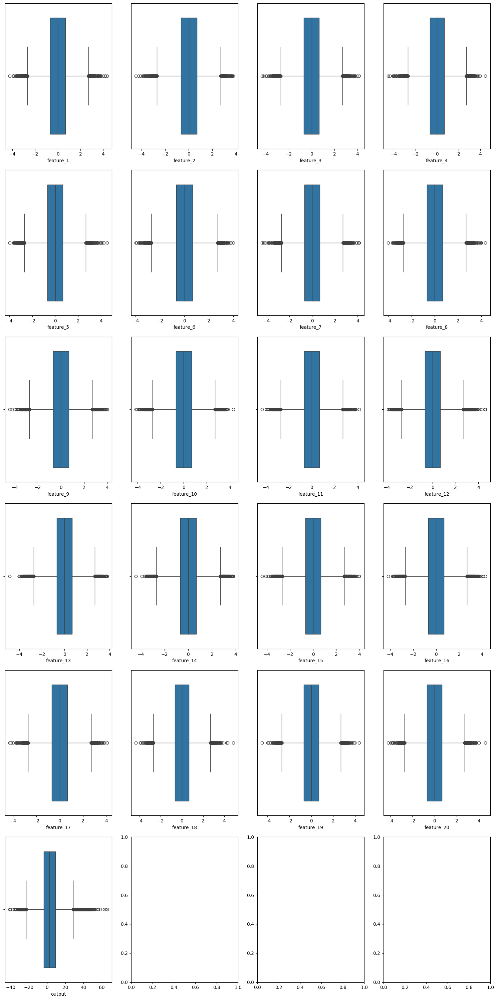

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Calculate the number of rows and columns for the subplots
num_cols = 4
num_rows = int(np.ceil(len(df.columns) / num_cols))

# Create a figure and axes for the subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))

# Iterate through the columns and create box plots
for i, name in enumerate(df.columns):
    row = i // num_cols
    col = i % num_cols
    sns.boxplot(x=name, data=df, ax=axes[row, col])

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

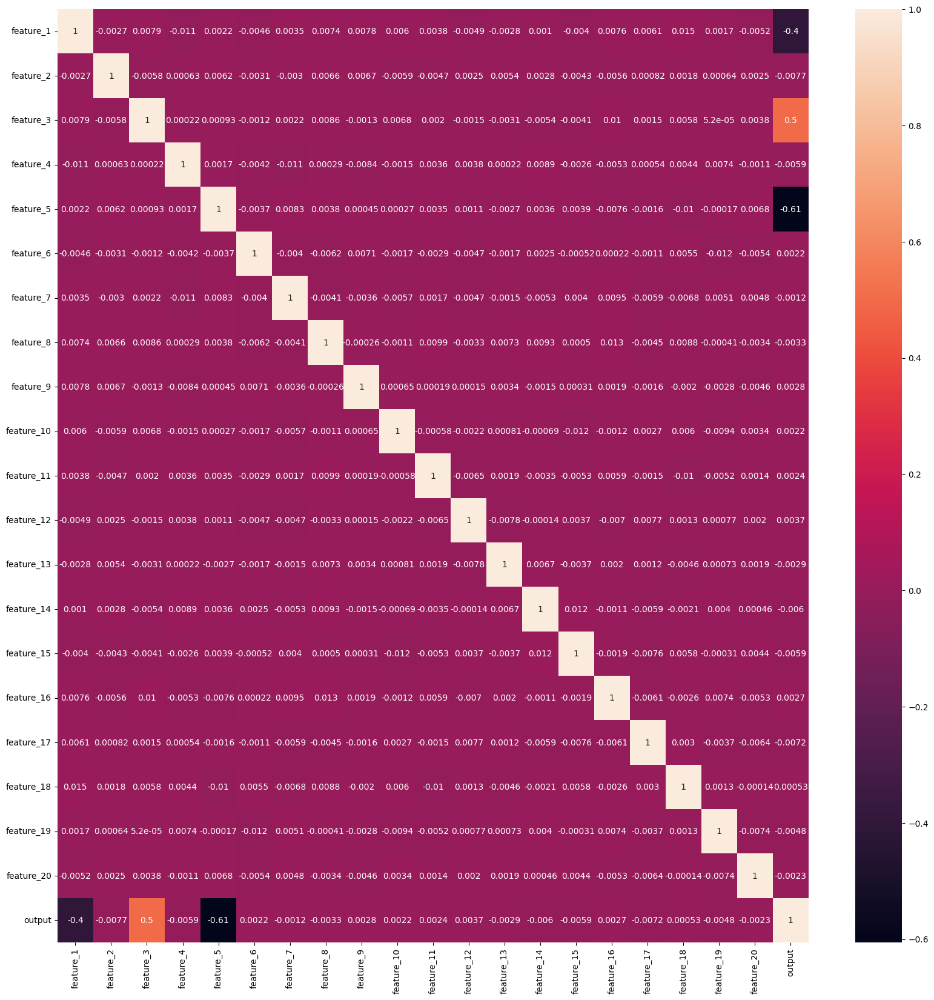

In [12]:
plt.figure(figsize=(20, 20))
correlation_matrix = df.corr()
sns.heatmap(correlation_matrix, annot=True)
plt.show()

## Explore behavior

In [13]:
from sklearn.decomposition import PCA
import numpy as np

def get_explained_variance(df):
    # Assuming data is a list of vectors (a 2D array)
    data = df.copy()
    # Handle NaN values - Imputation with mean
    data = data.fillna(data.mean()) # Replace NaN with the mean of each column
    # Alternative: Remove rows with NaN
    # data = data.dropna()

    # Perform PCA
    pca = PCA()
    pca.fit(data)

    # Explained variance by each principal component
    explained_variance = pca.explained_variance_ratio_
    cumulative_variance = np.cumsum(explained_variance)

    print("Explained Variance Ratio: ", explained_variance.shape)
    print("Cumulative Variance: ", cumulative_variance.shape)

    import matplotlib.pyplot as plt

    # Plot cumulative variance
    plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker='o')
    # plt.plot(np.arange(1, len(cumulative_variance) + 1), cumulative_variance, marker='o')
    plt.xlabel('Number of Principal Components')
    plt.ylabel('Cumulative Variance Explained')
    plt.title('Cumulative Variance vs Number of Principal Components')
    plt.grid(True)
    plt.show()

    # plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker='o')
    plt.plot(np.arange(1, len(cumulative_variance) + 1), cumulative_variance, marker='o')
    plt.xlabel('Number of Principal Components')
    plt.ylabel('Cumulative Variance Explained')
    plt.title('Cumulative Variance vs Number of Principal Components')
    plt.grid(True)
    plt.show()


Explained Variance Ratio:  (20,)
Cumulative Variance:  (20,)


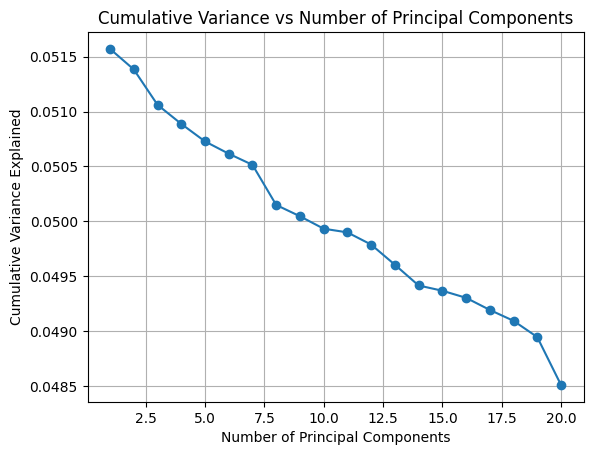

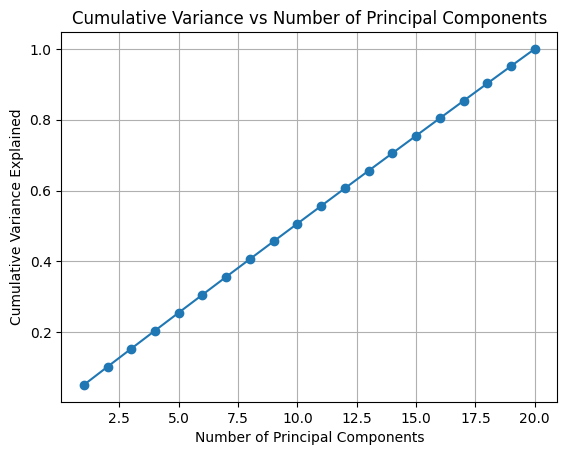

Explained Variance Ratio:  (20,)
Cumulative Variance:  (20,)


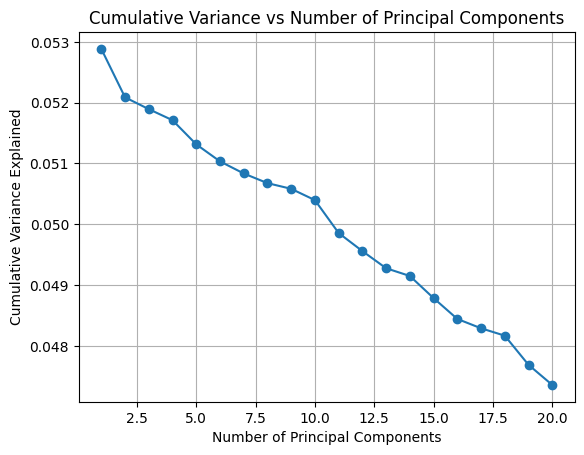

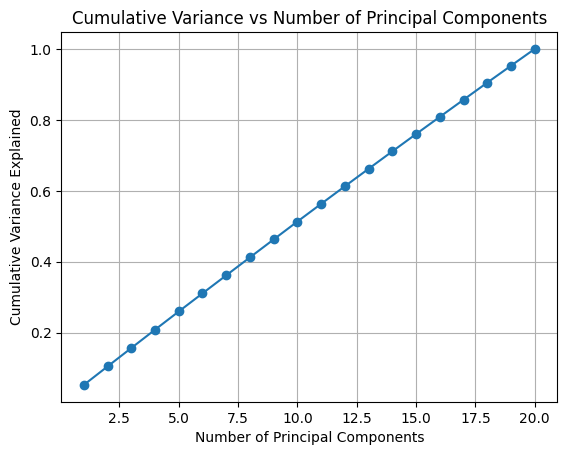

In [14]:
get_explained_variance(train_data.iloc[:, :-1])
get_explained_variance(test_data.iloc[:, :-1])

In [15]:
!pip install umap-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 5.6 MB/s eta 0:00:00


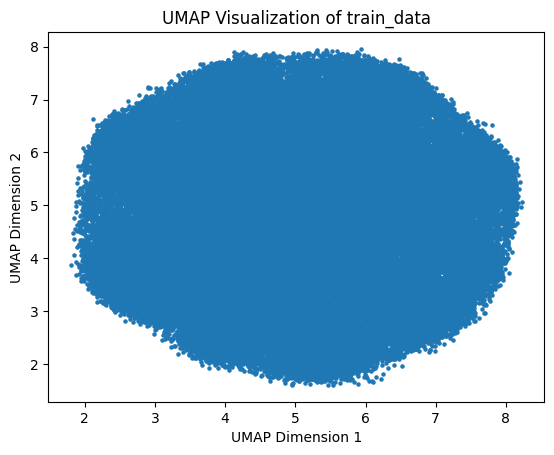

In [16]:
# !pip install umap-learn

import umap
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def draw_umap(data):
    """Draws a UMAP visualization of the input data."""

    # Convert data to DataFrame if not already
    data = pd.DataFrame(data)

    # Handle NaN values - Imputation with mean
    data = data.fillna(data.mean())

    # Apply UMAP dimensionality reduction
    reducer = umap.UMAP(n_components=2)  # Reduce to 2 dimensions for visualization
    embedding = reducer.fit_transform(data)

    # Plot the embedding
    plt.scatter(embedding[:, 0], embedding[:, 1], s=5)  # Adjust 's' for point size
    plt.title('UMAP Visualization of train_data')
    plt.xlabel('UMAP Dimension 1')
    plt.ylabel('UMAP Dimension 2')
    plt.show()

draw_umap(train_data.iloc[:, :-1].to_numpy())

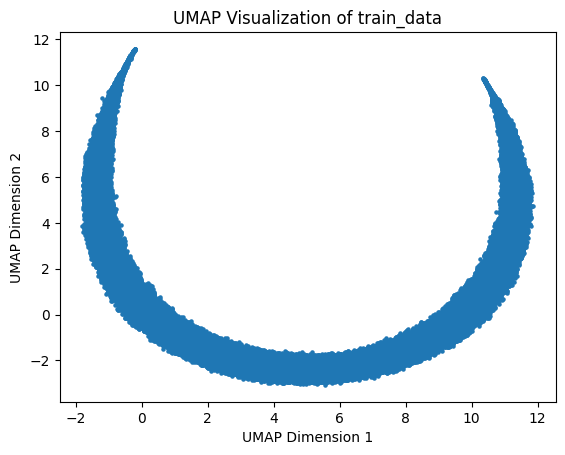

In [17]:
draw_umap(train_data.to_numpy())

# Process

## Main

In [18]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.pipeline import Pipeline
import pandas as pd


# Create the pipeline
best_k = 11 # because we use brute force
pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),            # Fill NaN values with the mean
    # ('scaler_0', StandardScaler()),                       # Standardize the data
    # ('pca_0', PCA(n_components=20)),                      # Apply PCA
    # ('poly', PolynomialFeatures(degree=2)),               # Generate polynomial features
    # ('scaler', StandardScaler()),                         # Standardize the data
    # ('pca', PCA(n_components=0.95)),                      # Apply PCA
    ('select', SelectKBest(f_regression, k=best_k)),        # get features
])

def get_pipe_data(df, y, isfit=True):
    X = pd.DataFrame(df)
    if isfit:
        X = pipeline.fit_transform(X, y)  # Fit and transform in one step
    else:
        X = pipeline.transform(X)  # Only transform if already fitted
    col_names = pipeline.named_steps['select'].get_feature_names_out()
    X = pd.DataFrame(X, columns=col_names)
    return X

get_pipe_data(train_data.iloc[:, :-1], train_data.iloc[:, -1], True)

,x0,x1,x2,x3,x4,x7,x11,x13,x14,x16,x18
0,0.910187,-0.831170,-0.226428,-0.002284,-0.875475,-0.512556,-1.146077,-0.134081,-0.702698,1.851776,0.003763
1,0.003417,0.003507,0.629110,-0.002284,0.470202,-1.613149,-0.004280,-0.001205,0.515115,1.011613,0.003763
2,0.348541,2.525876,-0.007777,-0.002284,-0.318007,0.002342,-1.668386,0.283982,-0.000409,-0.002213,-1.111602
3,0.159977,0.003507,1.553130,0.220560,0.482858,-1.239851,0.822290,-0.275694,1.053683,1.112376,0.003763
4,0.003417,-0.525681,1.186990,-0.381421,0.004007,0.639371,-0.004280,1.436179,1.833793,-0.002213,0.462849
...,...,...,...,...,...,...,...,...,...,...,...
79995,0.003417,-0.044812,-0.007777,-0.002284,0.004007,-0.885456,0.793136,-0.001205,-0.000409,0.684924,0.800815
79996,-0.842941,-0.596813,-0.081617,0.840165,0.004007,1.293752,-0.653812,-0.299700,0.343066,2.068271,-1.103795
79997,0.003417,0.003507,-1.583660,-0.002284,0.789714,-1.089665,0.748042,-0.001205,1.544420,-1.274629,-0.086250
79998,0.269784,0.003507,-1.025943,0.024647,-1.334827,0.822859,-0.062514,0.653008,2.484144,-0.002213,-0.202443


In [19]:
train = get_pipe_data(train_data.iloc[:, :-1], train_data.iloc[:, -1], False)
tmp = train_data.iloc[:, [-1]].copy()
train = pd.concat([train, tmp], axis=1)
train

,x0,x1,x2,x3,x4,x7,x11,x13,x14,x16,x18,output
0,0.910187,-0.831170,-0.226428,-0.002284,-0.875475,-0.512556,-1.146077,-0.134081,-0.702698,1.851776,0.003763,-0.946181
1,0.003417,0.003507,0.629110,-0.002284,0.470202,-1.613149,-0.004280,-0.001205,0.515115,1.011613,0.003763,14.133887
2,0.348541,2.525876,-0.007777,-0.002284,-0.318007,0.002342,-1.668386,0.283982,-0.000409,-0.002213,-1.111602,-1.430724
3,0.159977,0.003507,1.553130,0.220560,0.482858,-1.239851,0.822290,-0.275694,1.053683,1.112376,0.003763,4.648505
4,0.003417,-0.525681,1.186990,-0.381421,0.004007,0.639371,-0.004280,1.436179,1.833793,-0.002213,0.462849,5.178535
...,...,...,...,...,...,...,...,...,...,...,...,...
79995,0.003417,-0.044812,-0.007777,-0.002284,0.004007,-0.885456,0.793136,-0.001205,-0.000409,0.684924,0.800815,-13.609796
79996,-0.842941,-0.596813,-0.081617,0.840165,0.004007,1.293752,-0.653812,-0.299700,0.343066,2.068271,-1.103795,4.460943
79997,0.003417,0.003507,-1.583660,-0.002284,0.789714,-1.089665,0.748042,-0.001205,1.544420,-1.274629,-0.086250,-6.322682
79998,0.269784,0.003507,-1.025943,0.024647,-1.334827,0.822859,-0.062514,0.653008,2.484144,-0.002213,-0.202443,1.808187


In [21]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV


# Assuming 'train' is your pandas DataFrame
# and the last column is the target variable
X = train.iloc[:, :-1]  # Features
y = train.iloc[:, -1]   # Target

# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Create DMatrix for XGBoost (optimized data structure)
dtrain = xgb.DMatrix(X_train, label=y_train)
dval = xgb.DMatrix(X_val, label=y_val)


######################################################
### Training #########################################
######################################################
# Define the parameter grid to search
param_grid = {
    'learning_rate': [0.1],
    'max_depth': [3],
    'n_estimators': [300],
    # 'learning_rate': [0.01, 0.1, 0.2],
    # 'max_depth': [3, 5, 7],
    # 'n_estimators': [100, 200, 300],
    # Add other hyperparameters you want to tune
}

# Create GridSearchCV object
grid_search = GridSearchCV(
    estimator=xgb.XGBRegressor(objective='reg:squarederror', tree_method='gpu_hist', eval_metric='mae'),
    param_grid=param_grid,
    scoring='neg_mean_absolute_error',  # Use MAE for scoring
    cv=5,  # Number of cross-validation folds
    verbose=2
)

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Get the best hyperparameters
best_params = grid_search.best_params_

# Train the model with the best hyperparameters
num_rounds = 1000
model = xgb.train(best_params, dtrain, num_rounds, evals=[(dval, 'eval')],
                early_stopping_rounds=10, verbose_eval=True)

print("Best Hyperparameters:", best_params)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:21] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:21] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserW

[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=300; total time=   0.6s


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=300; total time=   0.4s


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=300; total time=   0.4s


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:23] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:23] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=300; total time=   0.4s


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:23] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:23] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=300; total time=   0.4s
[0]	eval-rmse:9.59387
[1]	eval-rmse:9.32726
[2]	eval-rmse:9.09429
[3]	eval-rmse:8.88343
[4]	eval-rmse:8.69329
[5]	eval-rmse:8.52472
[6]	eval-rmse:8.36696
[7]	eval-rmse:8.22934
[8]	eval-rmse:8.08747
[9]	eval-rmse:7.96148


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:30:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.

  warnings.warn(smsg, UserWarning)


[10]	eval-rmse:7.83721
[11]	eval-rmse:7.72411
[12]	eval-rmse:7.62017
[13]	eval-rmse:7.52375
[14]	eval-rmse:7.41812
[15]	eval-rmse:7.33042
[16]	eval-rmse:7.24410
[17]	eval-rmse:7.16094
[18]	eval-rmse:7.08465
[19]	eval-rmse:7.01585
[20]	eval-rmse:6.94945
[21]	eval-rmse:6.87943
[22]	eval-rmse:6.81625
[23]	eval-rmse:6.75975
[24]	eval-rmse:6.70369
[25]	eval-rmse:6.65350
[26]	eval-rmse:6.59339
[27]	eval-rmse:6.54610
[28]	eval-rmse:6.50118
[29]	eval-rmse:6.45925
[30]	eval-rmse:6.41995
[31]	eval-rmse:6.37625
[32]	eval-rmse:6.33849
[33]	eval-rmse:6.30486
[34]	eval-rmse:6.26986
[35]	eval-rmse:6.24226
[36]	eval-rmse:6.21521
[37]	eval-rmse:6.18673
[38]	eval-rmse:6.15582
[39]	eval-rmse:6.13293
[40]	eval-rmse:6.10779
[41]	eval-rmse:6.08423
[42]	eval-rmse:6.06454
[43]	eval-rmse:6.04503
[44]	eval-rmse:6.02653
[45]	eval-rmse:6.00800
[46]	eval-rmse:5.99119
[47]	eval-rmse:5.97316
[48]	eval-rmse:5.95859
[49]	eval-rmse:5.94438
[50]	eval-rmse:5.93200
[51]	eval-rmse:5.91882
[52]	eval-rmse:5.90698
[53]	eval-r

In [23]:
from sklearn.metrics import mean_absolute_error
import xgboost as xgb


# Prepare the testcase
test = get_pipe_data(test_data.iloc[:, :-1], test_data.iloc[:, -1], False)
tmp = test_data.iloc[:, [-1]].copy()
test = pd.concat([test, tmp], axis=1)
X_test = test.iloc[:, :-1]  # Features
y_test = test.iloc[:, -1]  # Assuming the last column is the target variable

# Convert X_test to DMatrix before prediction
dtest = xgb.DMatrix(X_test)  # Create DMatrix for test data

# Get predictions on the test data
y_pred = model.predict(dtest)  # Use dtest instead of X_test

# Calculate MAE
mae = mean_absolute_error(y_test, y_pred)

# Print the MAE
print(f"MAE: {mae:.4f}")

MAE: 3.8636


## Scan

In [ ]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.metrics import mean_absolute_error

# Assuming 'train_data' is your pandas DataFrame
# and the last column is the target variable
X = train.iloc[:, :-1]  # Features
y = train.iloc[:, -1]   # Target

# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a range of 'k' values to try for feature selection
k_values = range(1, X_train.shape[1] + 1)  # Try all possible feature combinations

best_mae = float('inf')  # Initialize with a large value
best_k = None

for k in k_values:
    # Create a feature selector (e.g., SelectKBest)
    selector = SelectKBest(f_regression, k=k)  # Select 'k' best features

    # Fit the selector to the training data
    selector.fit(X_train, y_train)

    # Transform the training and validation data
    X_train_selected = selector.transform(X_train)
    X_val_selected = selector.transform(X_val)

    # Create DMatrix for XGBoost
    dtrain = xgb.DMatrix(X_train_selected, label=y_train)
    dval = xgb.DMatrix(X_val_selected, label=y_val)

    # Set parameters for XGBoost
    params = {
        'objective': 'reg:squarederror',
        'tree_method': 'gpu_hist',
        'eval_metric': 'mae',
        # Add other hyperparameters as needed
    }

    # Train the XGBoost model
    num_rounds = 500  # Adjust if needed
    model = xgb.train(params, dtrain, num_rounds, evals=[(dval, 'eval')],
                      early_stopping_rounds=10, verbose_eval=False)  # Set verbose_eval=False to suppress output

    # Make predictions on the validation set
    y_pred = model.predict(dval)

    # Calculate MAE
    mae = mean_absolute_error(y_val, y_pred)
    print(f"MAE with {k} features: {mae}")

    # Update best MAE and k if current model is better
    if mae < best_mae:
        best_mae = mae
        best_k = k


print(f"Best MAE: {best_mae}")
print(f"Best k (number of features): {best_k}")

# Now you can use 'best_k' to select the best features for your final model
# ...

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:58] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 1 features: 6.644184035475353
MAE with 2 features: 5.608967502625741


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:58] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserW

MAE with 3 features: 4.922064597336491


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 4 features: 4.9299410948946685


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 5 features: 4.80544563878599


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 6 features: 4.810145487038854


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:10:59] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 7 features: 4.822174757613559


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 8 features: 4.812180497189764
MAE with 9 features: 4.818083784290853


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 10 features: 4.815335101353956
MAE with 11 features: 3.9747061582715286


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:00] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:01] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserW

MAE with 12 features: 3.9748973180304867
MAE with 13 features: 3.9821320619245215


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:01] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:01] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 14 features: 3.983724144896999
MAE with 15 features: 3.9931653953743598
MAE with 16 features: 3.990028044578152


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:01] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:01] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:02] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserW

MAE with 17 features: 3.9901612818757886
MAE with 18 features: 3.9966889587282526


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:02] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:11:02] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


MAE with 19 features: 3.9942817953010046
MAE with 20 features: 3.9912318655042522
Best MAE: 3.9747061582715286
Best k (number of features): 11


# Report

# **Machine Learning Pipeline for Regression Analysis with Feature Selection**

---

## **Author**
- **Full Name**: Quan Hoang Ngoc  
- **ID**: 22521178  

---

## **Overview**
This project explores a machine learning pipeline designed to handle and preprocess datasets for regression tasks. It includes exploratory data analysis, feature engineering, dimensionality reduction, model training, hyperparameter optimization, and evaluation. The implementation uses Python and popular libraries such as **PyTorch**, **XGBoost**, **Scikit-learn**, **UMAP**, and **Matplotlib**.

---

## **Project Workflow**

### 1. **Setup and Environment**
- The environment is prepared with necessary dependencies and file paths configured.

### 2. **Dataset Loading**
- The dataset is loaded from serialized `.pkl` files (`train_data.pkl` and `test_data.pkl`).
- After loading, the datasets are merged into Pandas DataFrames for easier inspection and manipulation.

### 3. **Exploratory Data Analysis (EDA)**
- **Distributions**: Visualized using histograms and pair plots.
- **Outliers**: Identified using box plots for each feature.
- **Correlation**: Analyzed with a heatmap of the correlation matrix.
- **Principal Component Analysis (PCA)**: Evaluated cumulative variance explained by principal components.
- **UMAP**: Applied for dimensionality reduction and data visualization.

### 4. **Feature Selection and Engineering**
- Built a pipeline using **Scikit-learn** for:
  - Imputation of missing values with the mean.
  - Feature selection using `SelectKBest` with F-regression.
- Feature selection optimization:
  - Iteratively tested feature subsets to identify the optimal number (`k`) of features with the lowest MAE.
- The pipeline extracts optimal features from the dataset for modeling.

### 5. **Model Training**
- Used **XGBoost** for regression tasks:
  - Hyperparameter optimization via `GridSearchCV`.
  - Validation using early stopping to prevent overfitting.
- The pipeline ensures training and validation sets are appropriately split and processed.

### 6. **Evaluation**
- Metrics:
  - Mean Absolute Error (MAE) for regression tasks.


---

## **Key Features**

### **1. Modular Pipeline**
- The use of **Scikit-learn pipelines** ensures modular, reusable, and interpretable preprocessing steps.

### **2. Dimensionality Reduction**
- **PCA** and **UMAP** provide insights into data behavior and relationships while reducing noise.

### **3. Automated Feature Selection**
- Brute force feature selection optimizes the model by testing various subsets of features for the best predictive performance.

### **4. Scalable Regression with XGBoost**
- **XGBoost**'s GPU-accelerated training delivers high performance, even on large datasets.

---

## **Results**
- **Optimal Features**: Identified using `SelectKBest`.
- **Best Hyperparameters**: Determined using `GridSearchCV`.
- **Evaluation**: Achieved optimal MAE after feature selection and model tuning: [***achive 3.8x on testset, not use cherry picking***]
- **Visualization**: Clear, interpretable plots for EDA and feature selection.

---

## **Future Work**
- Explore additional models and ensembles for improved performance.
- Extend the pipeline to include advanced hyperparameter optimization methods like Bayesian Optimization.
- Integrate interpretability tools like SHAP to understand feature importance.

---

Thank the professor! 